In [1]:
import numpy as np
import logging
import itertools
from tqdm import tqdm
import datetime
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
from sklearn.impute import SimpleImputer
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
from scipy.stats import chi2
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error,r2_score,mean_absolute_error 
from sklearn.preprocessing import StandardScaler
from sklearn.utils import shuffle

In [ ]:
df = pd.read_csv('/mnt/ffs24/home/lirui15/Research/Model1-ECFP/model1_reduced1_BCF.csv')

features = df.iloc[:, :-1] 
target = df.iloc[:, -1] 

In [ ]:
print(type(features))  
print(type(target))    
feature_names = features.columns.tolist()

<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>


In [ ]:
features, target = shuffle(features, target, random_state=42)

In [ ]:
X_train_val, X_test, Y_train_val, Y_test = train_test_split(features, target, test_size=0.1, random_state=42)

X_train, X_val, Y_train, Y_val = train_test_split(X_train_val, Y_train_val, test_size=0.2, random_state=42)

In [ ]:
model2 = XGBRegressor(n_estimators= 100,random_state=100,early_stopping_rounds=10)

In [ ]:
best_params = {
    'n_estimators': 120,
    'learning_rate': 0.1,
    'max_depth': 9,
    'min_child_weight': 1,
    'gamma': 0.0,
    'subsample': 0.7,
    'random_state':100
}

model_best = XGBRegressor(**best_params)
model_best.fit(X_train,Y_train.values.ravel())

# Individual conditional expectation plot #

## Carbon chain length ##

/tmp/ipykernel_2039045/3707716241.py:7: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  Carbon_sam1[0] = Carbon_step_lst[0]
/tmp/ipykernel_2039045/3707716241.py:18: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  Carbon_sam1[0] = Carbon_step_lst[ii]


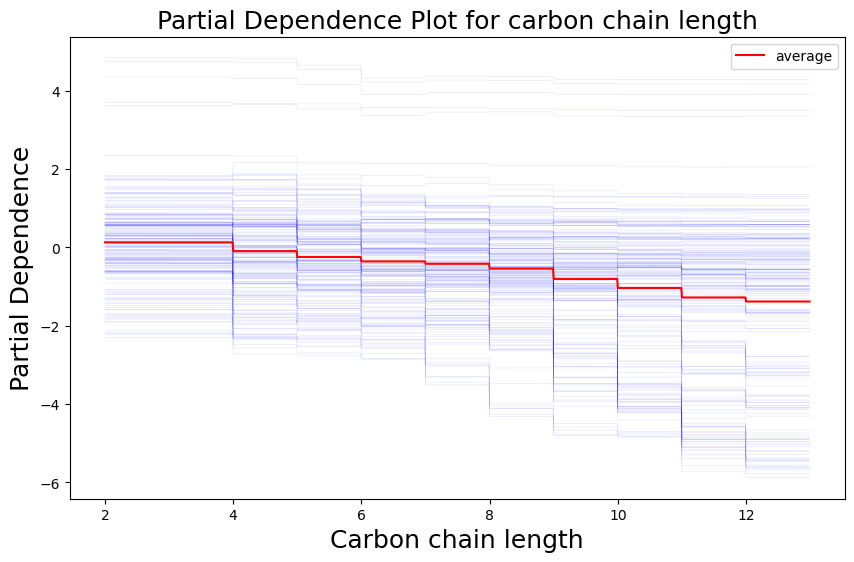

In [ ]:
Carbon_min = X_test.iloc[:, 0].min()
Carbon_max = X_test.iloc[:, 0].max()
Carbon_step_lst = np.arange(Carbon_min, Carbon_max, 0.01)

Carbon_sam1 = X_test.iloc[0, :].copy() 

Carbon_sam1[0] = Carbon_step_lst[0]

Carbon_sam_pred1 = model_best.predict([Carbon_sam1])[0]

Carbon_df = pd.DataFrame(index=np.arange(X_test.shape[0]), columns=list(np.arange(len(Carbon_step_lst))))

Carbon_df.iloc[0, 0] = Carbon_sam_pred1

for jj in range(X_test.shape[0]):
    for ii in range(len(Carbon_step_lst)):
        Carbon_sam1 = X_test.iloc[jj, :].copy()
        Carbon_sam1[0] = Carbon_step_lst[ii]
        Carbon_sam_pred1 = model_best.predict([Carbon_sam1])[0]
        Carbon_df.iloc[jj, ii] = Carbon_sam_pred1

Carbon_df_mean = Carbon_df.mean(axis=0)

plt.figure(figsize=(10, 6))
for ii in range(Carbon_df.shape[0]):
    plt.plot(Carbon_step_lst, Carbon_df.iloc[ii, :], alpha=0.12, c='blue', linewidth=0.4)

plt.plot(Carbon_step_lst, Carbon_df_mean, alpha=1, c='red', label="average")
plt.legend(loc=1, prop={'family': 'DejaVu Sans'})
font_dict = dict(fontsize=18, family='DejaVu Sans')
plt.xlabel('Carbon chain length', fontdict=font_dict)
plt.ylabel('Partial Dependence', fontdict=font_dict)
plt.title('Partial Dependence Plot for carbon chain length', fontdict=font_dict)
plt.show()

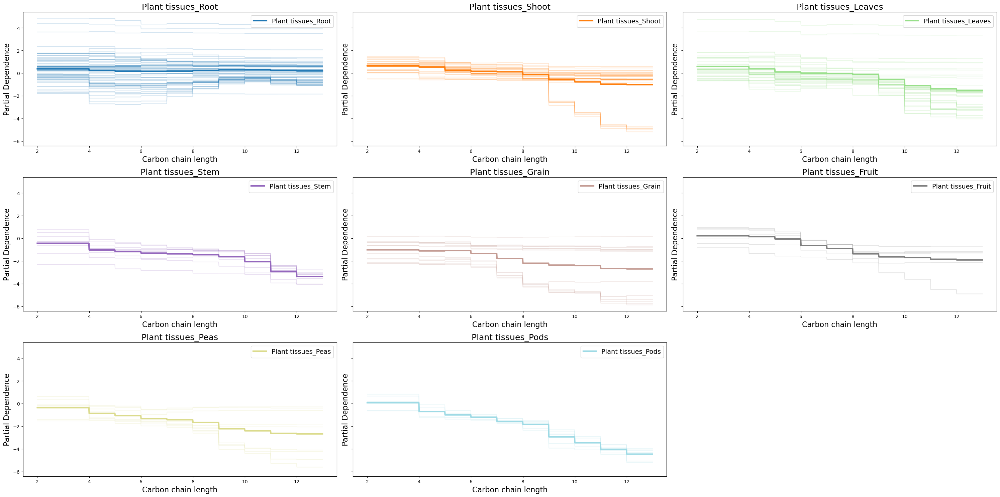

In [ ]:
selected_categories = ['Plant tissues_Root', 'Plant tissues_Shoot', 'Plant tissues_Leaves', 
                       'Plant tissues_Stem', 'Plant tissues_Grain', 'Plant tissues_Fruit',
                      'Plant tissues_Peas', 'Plant tissues_Pods']
#selected_categories = ['Plant tissues_Peas', 'Plant tissues_Pods', 'Plant tissues_Husk']

category_cols = [col for col in X_test.columns if col in selected_categories]

colors = plt.cm.tab20(np.linspace(0, 1, len(selected_categories)))
num_categories = len(selected_categories)
num_columns = 3 
num_rows = (num_categories + num_columns - 1) // num_columns  

fig, axes = plt.subplots(nrows=num_rows, ncols=num_columns, figsize=(30, 15), sharey=True)

axes = axes.flatten()

for ii, category in enumerate(selected_categories):
    mask = X_test[category] == 1
    sample_indices = np.where(mask)[0]
    
    filtered_Carbon_df = Carbon_df.loc[sample_indices, :]
    #filtered_Carbon_df.to_csv(f'Carbon_PDP_{category}.csv', index=False)
    category_mean = filtered_Carbon_df.mean(axis=0)
    
    for sample_idx in sample_indices:
        axes[ii].plot(Carbon_step_lst, Carbon_df.iloc[sample_idx, :], c=colors[ii], alpha=0.2)
    
    axes[ii].plot(Carbon_step_lst, category_mean, c=colors[ii], label=category, linewidth=3)
    
    axes[ii].set_title(category, fontsize=18, fontname='DejaVu Sans')
    axes[ii].set_xlabel('Carbon chain length', fontsize=16, fontname='DejaVu Sans')
    axes[ii].set_ylabel('Partial Dependence', fontsize=16, fontname='DejaVu Sans')
    axes[ii].legend(loc=1, prop={'size': 14, 'family': 'DejaVu Sans'})

for idx in range(num_categories, num_rows * num_columns):
    fig.delaxes(axes[idx])

plt.tight_layout()
plt.savefig('pdp-tissue-carbon.pdf', format='pdf')
plt.show()

## pH ##

/tmp/ipykernel_3637036/1896080943.py:7: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  pHsam1[3] = pH_step_lst[0]
/tmp/ipykernel_3637036/1896080943.py:17: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  pHsam1[3] = pH_step_lst[ii]


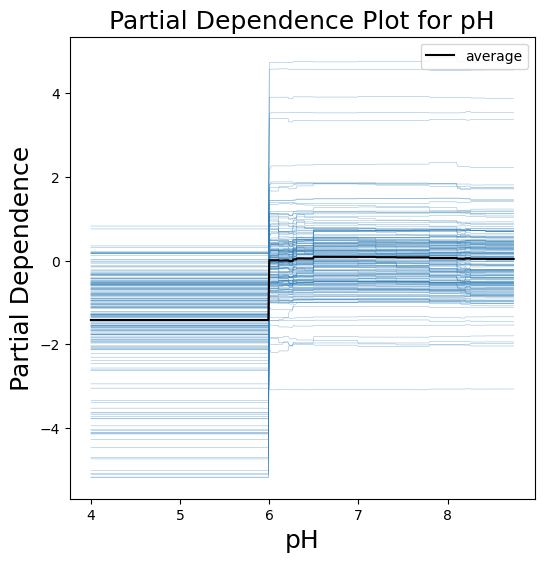

In [ ]:
pHmin = X_test.iloc[:, 3].min()
pHmax = X_test.iloc[:, 3].max()

pH_step_lst = np.arange(pHmin, pHmax, 0.01)

pHsam1 = X_test.iloc[0, :].copy() 
pHsam1[3] = pH_step_lst[0]

pHsam_pred1 = model_best.predict([pHsam1])[0]
pH_df = pd.DataFrame(index=np.arange(X_test.shape[0]), columns=list(np.arange(len(pH_step_lst))))

pH_df.iloc[0, 0] = pHsam_pred1

for jj in range(X_test.shape[0]):
    for ii in range(len(pH_step_lst)):
        pHsam1 = X_test.iloc[jj, :].copy()
        pHsam1[3] = pH_step_lst[ii]
        pHsam_pred1 = model_best.predict([pHsam1])[0]
        pH_df.iloc[jj, ii] = pHsam_pred1

pH_df_mean = pH_df.mean(axis=0)

plt.figure(figsize=(6, 6))
for ii in range(pH_df.shape[0]):
    plt.plot(pH_step_lst, pH_df.iloc[ii, :], alpha=0.5, c='#3480b8', linewidth=0.4)

plt.plot(pH_step_lst, pH_df_mean, alpha=1, c='black', label="average")
plt.legend(loc=1, prop={'family': 'DejaVu Sans'})
font_dict = dict(fontsize=18, family='DejaVu Sans')
plt.xlabel('pH', fontdict=font_dict)
plt.ylabel('Partial Dependence', fontdict=font_dict)
plt.title('Partial Dependence Plot for pH', fontdict=font_dict)
plt.savefig('pdp_pH.pdf', format='pdf', bbox_inches='tight')
plt.show()

## Initial concentration ##

## CEC ##

/tmp/local/53089671/ipykernel_3384580/1569562502.py:7: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  CEC_sam1[4] = CEC_step_lst[0]
/tmp/local/53089671/ipykernel_3384580/1569562502.py:18: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  CEC_sam1[4] = CEC_step_lst[ii]
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 

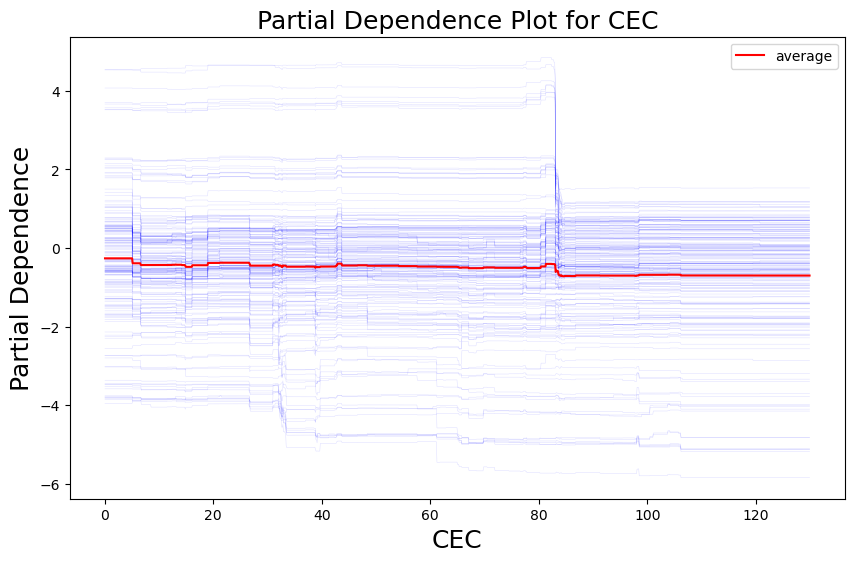

In [9]:
CEC_min = X_test.iloc[:, 4].min()
CEC_max = X_test.iloc[:, 4].max()
CEC_step_lst = np.arange(CEC_min, CEC_max, 0.1)

CEC_sam1 = X_test.iloc[0, :].copy()  

CEC_sam1[4] = CEC_step_lst[0]

CEC_sam_pred1 = model_mlp_best.predict([CEC_sam1])[0]

CEC_df = pd.DataFrame(index=np.arange(X_test.shape[0]), columns=list(np.arange(len(CEC_step_lst))))

CEC_df.iloc[0, 0] = CEC_sam_pred1

for jj in range(X_test.shape[0]):
    for ii in range(len(CEC_step_lst)):
        CEC_sam1 = X_test.iloc[jj, :].copy()
        CEC_sam1[4] = CEC_step_lst[ii]
        CEC_sam_pred1 = model_mlp_best.predict([CEC_sam1])[0]
        CEC_df.iloc[jj, ii] = CEC_sam_pred1

CEC_df_mean = CEC_df.mean(axis=0)

plt.figure(figsize=(10, 6))
for ii in range(CEC_df.shape[0]):
    plt.plot(CEC_step_lst, CEC_df.iloc[ii, :], alpha=0.12, c='blue', linewidth=0.4)

plt.plot(CEC_step_lst, CEC_df_mean, alpha=1, c='red', label="average")
plt.legend(loc=1, prop={'family': 'Arial'})
font_dict = dict(fontsize=18, family='Arial')
plt.xlabel('CEC', fontdict=font_dict)
plt.ylabel('Partial Dependence', fontdict=font_dict)
plt.title('Partial Dependence Plot for CEC', fontdict=font_dict)
plt.show()

## Exposure time ##

# 3D PDP #

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

def plot_3d_pdp(model, X, features, fixed_feature, fixed_value, grid_resolution=50):
    feature_1, feature_2, _ = features
    
    feature_1_vals = np.linspace(X[feature_1].min(), X[feature_1].max(), grid_resolution)
    feature_2_vals = np.linspace(X[feature_2].min(), X[feature_2].max(), grid_resolution)

    grid_1, grid_2 = np.meshgrid(feature_1_vals, feature_2_vals)

    grid_points = np.c_[grid_1.ravel(), grid_2.ravel()]
    X_grid = np.zeros((grid_points.shape[0], X.shape[1]))  
    X_grid[:, X.columns.get_loc(feature_1)] = grid_points[:, 0]
    X_grid[:, X.columns.get_loc(feature_2)] = grid_points[:, 1]
    
    # Set one-hot encoded columns
    plant_tissues_columns = [
        'Plant tissues_Root', 'Plant tissues_Shoot', 'Plant tissues_Leaves',
        'Plant tissues_Stem', 'Plant tissues_Grain', 'Plant tissues_Fruit',
        'Plant tissues_Peas','Plant tissues_Pods'
    ]
    
    for col in plant_tissues_columns:
        X_grid[:, X.columns.get_loc(col)] = 0
    
    X_grid[:, X.columns.get_loc(f'Plant tissues_{fixed_value}')] = 1

    preds = model.predict(X_grid).reshape(grid_1.shape)

    return grid_1, grid_2, preds
# Data preparation
X_full = pd.concat([X_train, X_val, X_test])
Y_full = pd.concat([Y_train, Y_val, Y_test])

features = ['Soil pH', 'Carbon chain length', 'Plant tissues']
fixed_feature = 'Plant tissues'
fixed_values = ['Root', 'Shoot', 'Leaves', 'Stem', 'Grain', 'Fruit', 'Peas', 'Pods']

# Create figure with better layout
fig = plt.figure(figsize=(18, 10), dpi=1200)  # Slightly larger figure
all_preds = []

# First pass to get global min and max
for value in fixed_values:
    _, _, preds = plot_3d_pdp(model_mlp_best, X_full, features, fixed_feature, value)
    all_preds.append(preds.ravel())

min_val = np.min(all_preds)
max_val = np.max(all_preds)
print(f"Prediction range: {min_val:.2f} to {max_val:.2f}")  # Debug output

# Create normalization and colormap
norm = Normalize(vmin=min_val, vmax=max_val)
cmap = plt.get_cmap('RdYlBu')

# Create scalar mappable for colorbar
sm = ScalarMappable(norm=norm, cmap=cmap)
sm.set_array([])

# Second pass to plot
for i, value in enumerate(fixed_values):
    ax = fig.add_subplot(2, 4, i+1, projection='3d')
    grid_1, grid_2, preds = plot_3d_pdp(model_mlp_best, X_full, features, fixed_feature, value)
    
    # Improved surface plot with better lighting
    surf = ax.plot_surface(
        grid_2, grid_1, preds,
        facecolors=cmap(norm(preds)),
        rstride=1, cstride=1,
        alpha=1,
        shade=False,  
        antialiased=True,
        linewidth=0,
        edgecolor='none'
    )
    
    ax.set_xlabel(features[1], labelpad=10)
    ax.set_ylabel(features[0], labelpad=10)
    ax.set_zlabel('Prediction', labelpad=10)
    ax.set_title(f'{fixed_feature}={value}', pad=15)
    ax.view_init(elev=30, azim=-40)
    ax.set_zlim(min_val, max_val)
    
    # Adjust grid and background for better visibility
    ax.xaxis.pane.fill = False
    ax.yaxis.pane.fill = False
    ax.zaxis.pane.fill = False
    ax.grid(True, linestyle='--', alpha=0.5)

# Add single colorbar on the right
cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
cbar = fig.colorbar(sm, cax=cbar_ax)
cbar.set_label('Prediction', rotation=270, labelpad=15)

# Adjust layout without tight_layout()
plt.subplots_adjust(left=0.05, right=0.9,  # Leave space for colorbar
                   bottom=0.1, top=0.95,
                   wspace=0.2, hspace=0.3)

plt.savefig("Carbon-pH-tissue2.pdf", format='pdf', bbox_inches='tight')
plt.show()

Prediction range: -3.87 to 1.18
